# Tutorial A : Single Qubit Operations and Visualization of the Qubit State
&nbsp;

```{tip}
**Remember, to interact with the code in this Quantum Programming tutorial, go over to the 'rocket' icon on the top right of your page and select "Live Demo"**.&nbsp; From there, you'll be able to rerun the code cells individually and edit the code. 
```

## Objectives: 
- to explore single-qubit gate operations.
- to visualize a single-qubit state. 
&nbsp;

For this first tutorial, we will apply **quantum gates** to a singular qubit to observe their effects on the qubit's state. 

We will need to **build a quantum circuit**. To do so, we are using the *Qiskit software development kit* or simply *Qiskit* which allows us to do quantum circuit computation in the *Python* programming language and *access the backend of IBM simulators and quantum devices*. 

&nbsp;
&nbsp;


## 1. Importing Qiskit SDK into our Python Editor 

By running the following programming code, we will be able to use *Qiskit* for the rest of the tutorial.

In [4]:
import qiskit
from qiskit import *

qiskit.__version__   # This tells us which version of Qiskit we have 

'0.19.2'

With *Qiskit* imported, we can now use its built-in functions to build our circuit. 
<br>


## 2. Creating a Quantum Circuit with One Qubit

To create a circuit, we use the `QuantumCircuit()` function. In the parentheses `()`, we will insert the number of qubits that we wish to have. In this case, we desire only one so we put: 


In [6]:
myquantumcircuit= QuantumCircuit(1)  # You can label your quantum circuit anything.

Above, we've called our quantum circuit `myquantumcircuit` and given it a single qubit.&nbsp; *Now*, let's draw our circuit to see what it looks like by using the `draw()` function. 

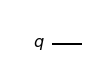

In [7]:
myquantumcircuit.draw(output='mpl')

**Great!** We have our first quantum circuit and it's that simple!<br>
In order to make *useful* circuit however, we'll need to perform operations, like adding a quantum gate and measuring to see what the qubit's state is. So let's do that now.
&nbsp; 
<br>

## 3. Applying a Quantum Gate

There are several **gates** that we can add to our circuit. But let's start with a simple one. 

For now we can apply an **X gate** which changes the state of our qubit to '1' if it is initially '0' *and* to '0' if it is initially '1'. 

```{note}
If you know about logic gates, it is analogous to the NOT gate. 
```
&nbsp; 

The `x()` function applies an **X gate**. Note that the 1st qubit in a circuit is label as the 0th qubit, hence we use `x(0)` to apply the `X` gate to the first qubit. 

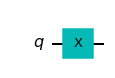

In [8]:
myquantumcircuit.x(0)

myquantumcircuit.draw(output='mpl')

We've drawn our circuit at once to see what it looks like, and now we see a box with an **'X'** added onto our qubit. &nbsp; 

The next step is to know what this gate does to the state of our qubit. For this we'll need to **measure** the circuit.   

<br>

## 4. Measurement of a Quantum Circuit

Measurement is necessary to **extract information** from our system. &nbsp; But remember, when we measure a quantum system, it *collapses* to a *classical state* so that we may no longer be able to perform *quantum computation* on said system.
For this reason, we leave measurement **as the very last step to our quantum circuit**. 
&nbsp;


To **measure**, we will need to add a classical bit to "collect" the information from the quantum bit.<br>
When we apply `measure_all()` and then `draw()`, the final circuit shows an **analog scale** icon with an *arrow* point to a new double line which appears below our first qubit. 

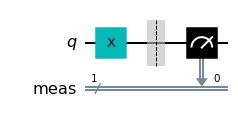

In [9]:
myquantumcircuit.measure_all()

myquantumcircuit.draw(output='mpl')

*However*, we still do not know what our measurement is. This is because **we haven't run our quantum circuit**!<br> All we have done until this point is to design a circuit *to be run* on a quantum computing device or a simulator. 

So now we have to establish a connection to a *quantum computer* or *simulator* to get our results. 
&nbsp;

## 5. Connecting to an IBM Quantum Device or Simulator. 
&nbsp;

IBM allows us to access some quantum computers and quantum simulators for free in the cloud. To find out which IBM quantum devices and simulators are available, click [here](https://quantum-computing.ibm.com/services/resources?services=simulators).

```{note}
Simulators are classical hardware made to mimic quantum hardware. 
```

&nbsp;
We'll use the Python-based `'qasm_simulator'` and we're calling it `sim` for short.

In [23]:
sim = BasicAer.get_backend('qasm_simulator')

Once we've defined our `sim`, let's go ahead and `execute()` our quantum circuit.

In [24]:
job=execute(myquantumcircuit,sim,shots=1)

*But where are the results?* <br>
We have definitely run the circuit, but we need new functions to display the results...
&nbsp; 

## 6. Getting Results

If we call the simply call `.result()`, it looks like this. 

In [25]:
job.result()

Result(backend_name='qasm_simulator', backend_version='2.1.0', qobj_id='9ff44cb2-a7f7-4efa-ba47-f3f115a849a4', job_id='57ef2e0a-94eb-4bc8-9db4-7f5859dd1849', success=True, results=[ExperimentResult(shots=1, success=True, meas_level=2, data=ExperimentResultData(counts={'0x1': 1}), header=QobjExperimentHeader(clbit_labels=[['meas', 0]], creg_sizes=[['meas', 1]], global_phase=0.0, memory_slots=1, metadata={}, n_qubits=1, name='circuit-1', qreg_sizes=[['q', 1]], qubit_labels=[['q', 0]]), status=DONE, name='circuit-1', seed_simulator=484230671, time_taken=0.006919384002685547)], status=COMPLETED, status=QobjHeader(backend_name='qasm_simulator', backend_version='2.1.0'), time_taken=0.006919384002685547)

Above tells us quite a lot, incltuding the job id, whether the job was successful, time taken and many more details. 

To simplify, we'll simply use `result().get_counts()` and `print()` to extract the result from `job`. 

In [26]:
myresult=job.result().get_counts()

print(myresult)

{'1': 1}


<br>
Our result reads that we measured the state '1' once for our qubit.<br>

Let's try running the circuit more than once. To do this, we change the number of `shots` in our `execute()` function. We'll run the circuit 50 times with `shots=50`.

In [29]:
multi_job=execute(myquantumcircuit,sim,shots=50)

myresult=multi_job.result().get_counts()

print(myresult)

{'1': 50}


Now we see that we got the result '1' each time.<br>

This is expected as Qiskit initializes qubits in the state '0' unless we specify it to initialize in another state.
Then we applied an **X gate** which *flipped our qubit* from the '0' state to the '1' state.

There's nothing *too interesting* right now, but let's find another way to visualize our results. 
&nbsp; 

## 7. Visualizing Results

We can plot **histograms** of our results by using another module from *Qiskit*.&nbsp; We'll import the module now. 

In [30]:
from qiskit.visualization import *

The module `qiskit.visualization` is imported.&nbsp; Now we can plot the histogram. 

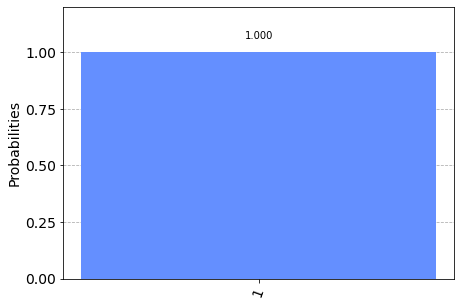

In [31]:
plot_histogram(myresult)

**Super!** We now have a histogram of our result. The histogram is clear that we got the state '1' with 100% probability. 

There are other cool ways to plot our results, but for that we'll need to use the backend of the `statevector_simulator` instead. We'll do this in **Tutorial B** when we have a more interesting circuit. 

Let's try something else... Here's a cool way to see what happens to our qubit using the Bloch sphere representation. 

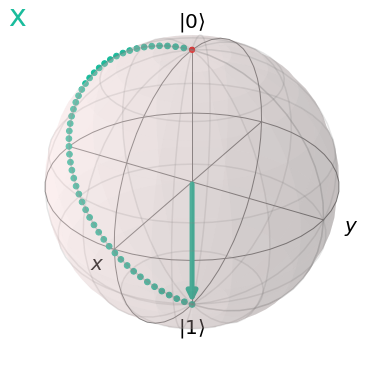

In [33]:
myquantumcircuit2= QuantumCircuit(1)  # Recreating the same circuit with 1 qubit

myquantumcircuit2.x(0)  # Recreating the circuit by adding an X gate

visualize_transition(myquantumcircuit2, trace=True, saveas=None, fpg=50, spg=2)

**Cool!** The state of our qubit went from $|0\rangle$ to $|1\rangle$ by rotating $180^\circ$. Let's look at some more interesting quantum gates. 
&nbsp; 

## 8. Playing with Superposition

A gate that we definitely need to take a look at is the gate that creates a **superposition**. It's called a **Hadamard** gate and we use the function `h()` to apply it to a qubit.

Let's apply it now.

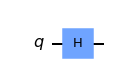

In [46]:
superpositioncircuit=QuantumCircuit(1) # Make a circuit with 1 qubit

superpositioncircuit.h(0) # Apply Hadamard gate

superpositioncircuit.draw(output='mpl') # draw circuit

 Right, now we have a new circuit with a 'Hadamard' gate.&nbsp; Let's visualize what happens to the qubit. 

In [ ]:
visualize_transition(superpositioncircuit, trace=False, saveas=None, fpg=50, spg=2)

**Did you see that?** <br> 
The qubit did not go all the way to the state $|1\rangle$. It stopped midway between. This is our superposition state of $|0\rangle+|1\rangle$.&nbsp; It's in both $|0\rangle$ and $|1\rangle$ at the same time.
&nbsp; But let's see what happens when we measure the circuit...

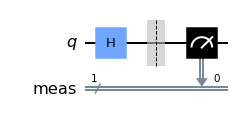

In [36]:
superpositioncircuit.measure_all() # Do the measurement on all qubits

superpositioncircuit.draw(output='mpl') # Draw the circuit 

In [41]:
superpositionjob=execute(superpositioncircuit, sim, shots=100) # Execute the circuit with 100 shots

superpositionresult=superpositionjob.result().get_counts() # Get the result

print(superpositionresult) # Print the result

{'1': 56, '0': 44}


When we measured our circuit, we got two possible results: the $|0\rangle$ state **and** the $|1\rangle$ state.&nbsp; This is because when we measure a superposed state, the qubit "chooses" between one of the measurable states. For our 100 executions of the circuit, we should get a fairly equal split, about 50-50 for the $|0\rangle$ and $|1\rangle$ states. 

```{tip}
Try rerunning the above code cell again and see if you get a *slightly* changed result.  
```
&nbsp; 
An now to plot the histogram... 

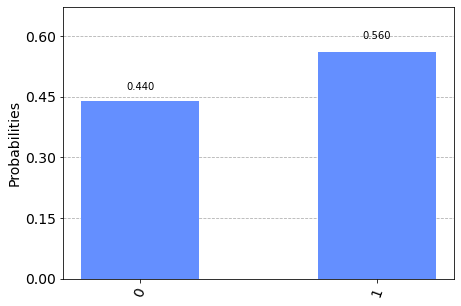

In [42]:
plot_histogram(superpositionresult)

## 9. Applying More than One Gate

Let's now apply more than one gate to the same qubit. 

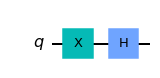

In [49]:
moregates=QuantumCircuit(1)

moregates.x(0)

moregates.h(0)

moregates.draw(output='mpl')

We've applied an `X` gate followed by a `Hadamard` gate.

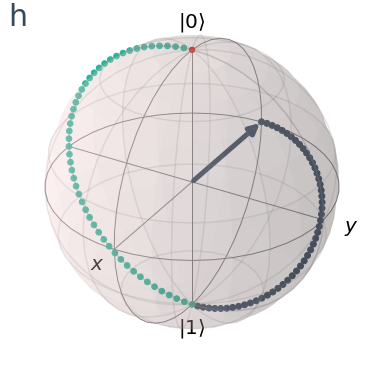

In [51]:
visualize_transition(moregates, trace=True, saveas=None, fpg=50, spg=2)

From above, we see two transitions. The first transition shows the flip of the qubit's state from $|0\rangle$ to $|1\rangle$, after which the second transition takes the qubit from $|1\rangle$ to an equal superposition state. This state is slightly different to the superposition state that we saw previously. In fact, what we saw before was the $|0\rangle + |1\rangle $. What we see right above is the $|0\rangle -|1\rangle$ state.

```{note}
The Hadamard gate takes a qubit in state $|0\rangle$ to the superposed state $|0\rangle + |1\rangle$. On the other hand, the Hadamard gate takes a qubit in state $|1\rangle$ to the superposed state $|0\rangle - |1\rangle$. 
```

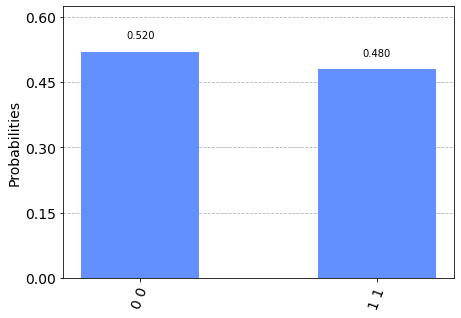

In [54]:
moregates.measure_all()  # We must measure first before executing

job=execute(moregates, sim, shots=100)

counts= job.result().get_counts()

plot_histogram(counts)

By executing the circuit, we see that there is no measurable difference between the $|0\rangle - |1\rangle$ state and the $|0\rangle +|1\rangle$ state from before. *At least not using this measurement basis...*

## 10. Applying the Same Gate Twice

Something interesting occurs when we apply some gates twice. Let's see. 

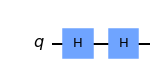

In [55]:
samegatetwice= QuantumCircuit(1)

samegatetwice.h(0)

samegatetwice.h(0)

samegatetwice.draw(output='mpl')

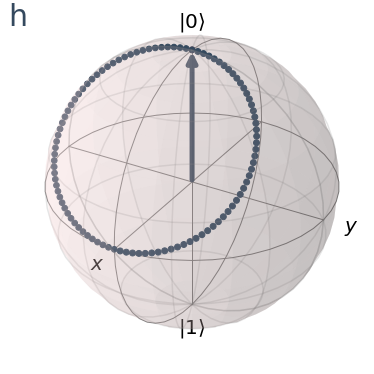

In [56]:
visualize_transition(samegatetwice, trace=True, saveas=None, fpg=50, spg=2)

*Hmmm* <br>
How about if we started from the state $|1\rangle$ and applied the `Hadamard` twice. 

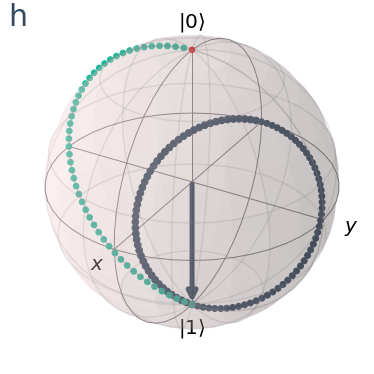

In [57]:
samegatetwice2=QuantumCircuit(1)

samegatetwice2.x(0)  # flipping to state 1 first

samegatetwice2.h(0)

samegatetwice2.h(0)

visualize_transition(samegatetwice2, trace=True, saveas=None, fpg=50, spg=2)

That's right. Applying the same Hadamard gate twice is the same as applying no gates at all, i.e. it's an *identity* operator. This is the case for many quantum gates, but not *all*. Gates that show this are said to be *Hermitian* and *Unitary*. Being both Hermitian and Unitary means that the gate is its own inverse. 


**That's the end of Tutorial A. Congratulations!** You know have a handle on basic quantum programming. <br>

In **Tutorial B**, we'll look at other cool quantum gates. *In the meantime...*

# **Try Your Own Code**

**We leave you this space to enter and play around with your own quantum programming code**. &nbsp; You may want to restart the kernel. 

In [1]:
import qiskit 
from qiskit import *
from qiskit.visualization import *






